In [0]:
%pip install mlxtend --quiet

Python interpreter will be restarted.
Python interpreter will be restarted.


In [0]:
from pyspark.sql.functions import to_date, regexp_replace, round, col, row_number, countDistinct, date_format, dayofyear
from pyspark.sql.window import Window
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

In [0]:
dataPath = "/FileStore/tables/Online_Retail.csv"

In [0]:
data = spark.read.csv(dataPath, header=True, inferSchema=True)

In [0]:
display(data)

InvoiceNo,StockCode,Description,Quantity,UnitPrice,CustomerID,Country,InvoiceDate,Year,Month,Week,Day,DayOfWeek
536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2.55,17850,United Kingdom,2010-01-12T08:26:00.000+0000,2010,1,2,12,1
536365,71053,WHITE METAL LANTERN,6,3.39,17850,United Kingdom,2010-01-12T08:26:00.000+0000,2010,1,2,12,1
536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2.75,17850,United Kingdom,2010-01-12T08:26:00.000+0000,2010,1,2,12,1
536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,3.39,17850,United Kingdom,2010-01-12T08:26:00.000+0000,2010,1,2,12,1
536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,3.39,17850,United Kingdom,2010-01-12T08:26:00.000+0000,2010,1,2,12,1
536365,22752,SET 7 BABUSHKA NESTING BOXES,2,7.65,17850,United Kingdom,2010-01-12T08:26:00.000+0000,2010,1,2,12,1
536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,4.25,17850,United Kingdom,2010-01-12T08:26:00.000+0000,2010,1,2,12,1
536366,22633,HAND WARMER UNION JACK,6,1.85,17850,United Kingdom,2010-01-12T08:28:00.000+0000,2010,1,2,12,1
536366,22632,HAND WARMER RED POLKA DOT,6,1.85,17850,United Kingdom,2010-01-12T08:28:00.000+0000,2010,1,2,12,1
536367,84879,ASSORTED COLOUR BIRD ORNAMENT,32,1.69,13047,United Kingdom,2010-01-12T08:34:00.000+0000,2010,1,2,12,1


In [0]:
#Checking all datatypes of our dataframe
data.dtypes

Out[5]: [('InvoiceNo', 'int'),
 ('StockCode', 'string'),
 ('Description', 'string'),
 ('Quantity', 'int'),
 ('UnitPrice', 'double'),
 ('CustomerID', 'int'),
 ('Country', 'string'),
 ('InvoiceDate', 'timestamp'),
 ('Year', 'int'),
 ('Month', 'int'),
 ('Week', 'int'),
 ('Day', 'int'),
 ('DayOfWeek', 'int')]

In [0]:
data = data.withColumn('InvoiceDate', to_date(data.InvoiceDate))
data = data.withColumn('InvoiceDate', date_format("InvoiceDate", 'dd-MM-yyyy'))

In [0]:
display(data)

InvoiceNo,StockCode,Description,Quantity,UnitPrice,CustomerID,Country,InvoiceDate,Year,Month,Week,Day,DayOfWeek
536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2.55,17850,United Kingdom,12-01-2010,2010,1,2,12,1
536365,71053,WHITE METAL LANTERN,6,3.39,17850,United Kingdom,12-01-2010,2010,1,2,12,1
536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2.75,17850,United Kingdom,12-01-2010,2010,1,2,12,1
536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,3.39,17850,United Kingdom,12-01-2010,2010,1,2,12,1
536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,3.39,17850,United Kingdom,12-01-2010,2010,1,2,12,1
536365,22752,SET 7 BABUSHKA NESTING BOXES,2,7.65,17850,United Kingdom,12-01-2010,2010,1,2,12,1
536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,4.25,17850,United Kingdom,12-01-2010,2010,1,2,12,1
536366,22633,HAND WARMER UNION JACK,6,1.85,17850,United Kingdom,12-01-2010,2010,1,2,12,1
536366,22632,HAND WARMER RED POLKA DOT,6,1.85,17850,United Kingdom,12-01-2010,2010,1,2,12,1
536367,84879,ASSORTED COLOUR BIRD ORNAMENT,32,1.69,13047,United Kingdom,12-01-2010,2010,1,2,12,1


In [0]:
data.select('Country').distinct().collect()

Out[8]: [Row(Country='Sweden'),
 Row(Country='Singapore'),
 Row(Country='Germany'),
 Row(Country='France'),
 Row(Country='Greece'),
 Row(Country='Belgium'),
 Row(Country='Finland'),
 Row(Country='Italy'),
 Row(Country='EIRE'),
 Row(Country='Lithuania'),
 Row(Country='Norway'),
 Row(Country='Spain'),
 Row(Country='Denmark'),
 Row(Country='Iceland'),
 Row(Country='Channel Islands'),
 Row(Country='Cyprus'),
 Row(Country='Switzerland'),
 Row(Country='Lebanon'),
 Row(Country='Japan'),
 Row(Country='Poland'),
 Row(Country='Portugal'),
 Row(Country='Australia'),
 Row(Country='Austria'),
 Row(Country='United Kingdom'),
 Row(Country='Netherlands'),
 Row(Country='Unspecified'),
 Row(Country='Israel'),
 Row(Country='Saudi Arabia'),
 Row(Country='United Arab Emirates'),
 Row(Country='Canada'),
 Row(Country='Czech Republic'),
 Row(Country='Brazil'),
 Row(Country='European Community'),
 Row(Country='Malta'),
 Row(Country='USA'),
 Row(Country='Bahrain'),
 Row(Country='RSA')]

In [0]:
data = data.withColumn('Country', regexp_replace('Country', 'RSA', 'South Africa'))
data = data.withColumn('Country', regexp_replace('Country', 'EIRE', 'Ireland'))

In [0]:
data = data.withColumn('QuantityPriceSum', data.Quantity * data.UnitPrice)

In [0]:
display(data)

InvoiceNo,StockCode,Description,Quantity,UnitPrice,CustomerID,Country,InvoiceDate,Year,Month,Week,Day,DayOfWeek,QuantityPriceSum
536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2.55,17850,United Kingdom,12-01-2010,2010,1,2,12,1,15.299999999999999
536365,71053,WHITE METAL LANTERN,6,3.39,17850,United Kingdom,12-01-2010,2010,1,2,12,1,20.34
536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2.75,17850,United Kingdom,12-01-2010,2010,1,2,12,1,22.0
536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,3.39,17850,United Kingdom,12-01-2010,2010,1,2,12,1,20.34
536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,3.39,17850,United Kingdom,12-01-2010,2010,1,2,12,1,20.34
536365,22752,SET 7 BABUSHKA NESTING BOXES,2,7.65,17850,United Kingdom,12-01-2010,2010,1,2,12,1,15.3
536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,4.25,17850,United Kingdom,12-01-2010,2010,1,2,12,1,25.5
536366,22633,HAND WARMER UNION JACK,6,1.85,17850,United Kingdom,12-01-2010,2010,1,2,12,1,11.100000000000001
536366,22632,HAND WARMER RED POLKA DOT,6,1.85,17850,United Kingdom,12-01-2010,2010,1,2,12,1,11.100000000000001
536367,84879,ASSORTED COLOUR BIRD ORNAMENT,32,1.69,13047,United Kingdom,12-01-2010,2010,1,2,12,1,54.08


In [0]:
countryWiseSalesData = data.groupBy(['Country', 'Year']).sum('QuantityPriceSum').withColumnRenamed("sum(QuantityPriceSum)", "TotalQuantityPriceSum")
countryWiseSalesData = countryWiseSalesData.withColumn("TotalQuantityPriceSum", round(countryWiseSalesData["TotalQuantityPriceSum"], 2))
countryWiseSalesData = countryWiseSalesData.orderBy("TotalQuantityPriceSum", ascending=False)
salesTotal2010 = countryWiseSalesData.filter(countryWiseSalesData.Year==2010)
salesTotal2011 = countryWiseSalesData.filter(countryWiseSalesData.Year==2011)

In [0]:
salesTotal2010.show(5)

+--------------+----+---------------------+
|       Country|Year|TotalQuantityPriceSum|
+--------------+----+---------------------+
|United Kingdom|2010|            363494.51|
|       Germany|2010|             13087.74|
|        France|2010|              8125.43|
|       Ireland|2010|              8103.24|
|        Norway|2010|              3382.96|
+--------------+----+---------------------+
only showing top 5 rows



In [0]:
salesTotal2011.show(5)

+--------------+----+---------------------+
|       Country|Year|TotalQuantityPriceSum|
+--------------+----+---------------------+
|United Kingdom|2011|           4756425.51|
|       Germany|2011|            172096.93|
|       Ireland|2011|            160962.43|
|        France|2011|            150268.59|
|   Netherlands|2011|             60973.52|
+--------------+----+---------------------+
only showing top 5 rows



In [0]:
topSellingProduct = data.groupBy(['Country', 'StockCode', 'Description']).sum('Quantity').withColumnRenamed('sum(Quantity)', 'quantitiesSold')
windowSpec = Window.partitionBy("Country").orderBy(col("quantitiesSold").desc())
bestSellingProducts = topSellingProduct.withColumn("rank", row_number().over(windowSpec)).filter(col("rank") <= 5)
display(bestSellingProducts)

Country,StockCode,Description,quantitiesSold,rank
Australia,22699,ROSES REGENCY TEACUP AND SAUCER,156,1
Australia,22090,PAPER BUNTING RETROSPOT,140,2
Australia,22698,PINK REGENCY TEACUP AND SAUCER,132,3
Australia,84978,HANGING HEART JAR T-LIGHT HOLDER,132,4
Australia,47590B,PINK HAPPY BIRTHDAY BUNTING,121,5
Austria,22556,PLASTERS IN TIN CIRCUS PARADE,48,1
Austria,21977,PACK OF 60 PINK PAISLEY CAKE CASES,48,2
Austria,21789,KIDS RAIN MAC PINK,48,3
Austria,21788,KIDS RAIN MAC BLUE,48,4
Austria,20975,12 PENCILS SMALL TUBE RED RETROSPOT,48,5


In [0]:
def countryTrendGenerator(countryName):
    countryTrends = data.filter(data.Country==countryName).groupBy(['InvoiceDate']).sum('QuantityPriceSum').withColumnRenamed("sum(QuantityPriceSum)", "dailyTotalSales").toPandas()
    countryTrends['InvoiceDate'] = pd.to_datetime(countryTrends['InvoiceDate'])
    countryTrends = countryTrends.sort_values('InvoiceDate')
    
    plt.rcParams['figure.figsize'] = [24, 8]

    plt.title(f"{countryName} Trend Graph")

    plt.plot(countryTrends['InvoiceDate'], countryTrends['dailyTotalSales'])


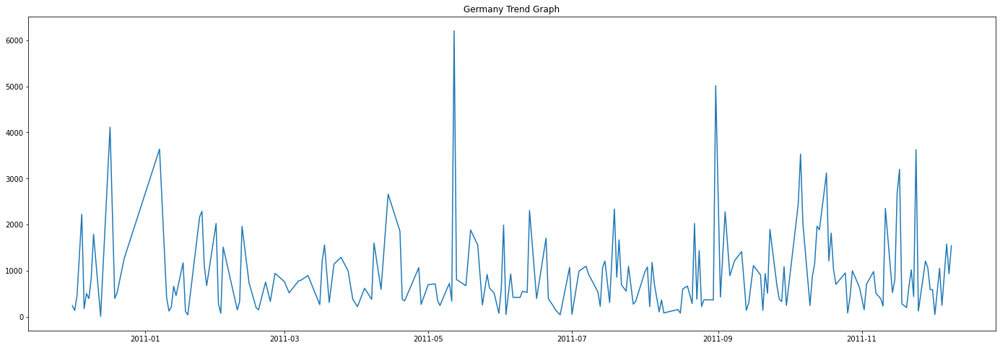

In [0]:
countryTrendGenerator('Germany')

In [0]:
display(data)

InvoiceNo,StockCode,Description,Quantity,UnitPrice,CustomerID,Country,InvoiceDate,Year,Month,Week,Day,DayOfWeek,QuantityPriceSum
536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2.55,17850,United Kingdom,12-01-2010,2010,1,2,12,1,15.299999999999999
536365,71053,WHITE METAL LANTERN,6,3.39,17850,United Kingdom,12-01-2010,2010,1,2,12,1,20.34
536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2.75,17850,United Kingdom,12-01-2010,2010,1,2,12,1,22.0
536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,3.39,17850,United Kingdom,12-01-2010,2010,1,2,12,1,20.34
536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,3.39,17850,United Kingdom,12-01-2010,2010,1,2,12,1,20.34
536365,22752,SET 7 BABUSHKA NESTING BOXES,2,7.65,17850,United Kingdom,12-01-2010,2010,1,2,12,1,15.3
536365,21730,GLASS STAR FROSTED T-LIGHT HOLDER,6,4.25,17850,United Kingdom,12-01-2010,2010,1,2,12,1,25.5
536366,22633,HAND WARMER UNION JACK,6,1.85,17850,United Kingdom,12-01-2010,2010,1,2,12,1,11.100000000000001
536366,22632,HAND WARMER RED POLKA DOT,6,1.85,17850,United Kingdom,12-01-2010,2010,1,2,12,1,11.100000000000001
536367,84879,ASSORTED COLOUR BIRD ORNAMENT,32,1.69,13047,United Kingdom,12-01-2010,2010,1,2,12,1,54.08


In [0]:
analysisData = data.select(['InvoiceNo', 'StockCode', 'Quantity', 'Country', 'InvoiceDate', 'QuantityPriceSum'])

In [0]:
display(analysisData)

InvoiceNo,StockCode,Quantity,Country,InvoiceDate,QuantityPriceSum
536365,85123A,6,United Kingdom,12-01-2010,15.299999999999999
536365,71053,6,United Kingdom,12-01-2010,20.34
536365,84406B,8,United Kingdom,12-01-2010,22.0
536365,84029G,6,United Kingdom,12-01-2010,20.34
536365,84029E,6,United Kingdom,12-01-2010,20.34
536365,22752,2,United Kingdom,12-01-2010,15.3
536365,21730,6,United Kingdom,12-01-2010,25.5
536366,22633,6,United Kingdom,12-01-2010,11.100000000000001
536366,22632,6,United Kingdom,12-01-2010,11.100000000000001
536367,84879,32,United Kingdom,12-01-2010,54.08


In [0]:
analysisDatadf = analysisData.toPandas()

In [0]:
print((analysisDatadf['Country'].value_counts()/analysisDatadf.shape[0])*100)

United Kingdom          89.791563
Germany                  2.209913
France                   2.038620
Ireland                  1.739442
Spain                    0.619410
Belgium                  0.496464
Switzerland              0.453835
Portugal                 0.367799
Netherlands              0.275004
Norway                   0.259669
Channel Islands          0.190268
Italy                    0.190008
Australia                0.186369
Finland                  0.159856
Cyprus                   0.155957
Austria                  0.098773
Denmark                  0.091495
Poland                   0.084217
Sweden                   0.073560
Unspecified              0.063423
Israel                   0.062123
Japan                    0.056664
Singapore                0.051206
Iceland                  0.047047
USA                      0.046007
Canada                   0.038469
Greece                   0.036910
Malta                    0.028332
United Arab Emirates     0.016895
European Commu

In [0]:
data

Out[23]: DataFrame[InvoiceNo: int, StockCode: string, Description: string, Quantity: int, UnitPrice: double, CustomerID: int, Country: string, InvoiceDate: string, Year: int, Month: int, Week: int, Day: int, DayOfWeek: int, QuantityPriceSum: double]

In [0]:
df = data.toPandas()

In [0]:
from mlxtend.frequent_patterns import apriori, association_rules
import pandas as pd


# Create a basket matrix
basket = (df.groupby(['InvoiceNo', 'StockCode'])['Quantity']
          .sum().unstack().reset_index().fillna(0)
          .set_index('InvoiceNo'))

# Convert quantities to 1s and 0s
basket_sets = basket.applymap(lambda x: 1 if x > 0 else 0)

# Apply Apriori algorithm
frequent_itemsets = apriori(basket_sets, min_support=0.02, use_colnames=True)

# Generate association rules
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1)

# rules DataFrame will now have the products that are frequently bought together.


/local_disk0/.ephemeral_nfs/envs/pythonEnv-4509a1d1-049e-4eea-9874-5f5a8cdcdfac/lib/python3.9/site-packages/mlxtend/frequent_patterns/fpcommon.py:109: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


In [0]:
print(rules.sort_values('confidence', ascending=False)[['antecedents', 'consequents', 'support', 'confidence']].to_string())

       antecedents     consequents   support  confidence
85  (22698, 22699)         (22697)  0.021605    0.894366
84  (22698, 22697)         (22699)  0.021605    0.841060
60         (22698)         (22697)  0.025688    0.826642
64         (22698)         (22699)  0.024157    0.777372
62         (22697)         (22699)  0.030054    0.777126
81         (23300)         (23301)  0.025688    0.724800
86  (22697, 22699)         (22698)  0.021605    0.718868
87         (22698)  (22697, 22699)  0.021605    0.695255
63         (22699)         (22697)  0.030054    0.691004
58         (22630)         (22629)  0.021888    0.671304
66         (22726)         (22727)  0.029770    0.670498
61         (22697)         (22698)  0.025688    0.664223
36         (21733)        (85123A)  0.024383    0.647590
68         (22728)         (22727)  0.022229    0.645799
40         (22910)         (22086)  0.024553    0.641481
48         (22386)        (85099B)  0.027389    0.620026
80         (23301)         (233